Filter method is less accurate. It is great while doing EDA(探索式資料分析), it can also be used for checking multi co-linearity in data.

In [1]:
# 連接 MySQL 資料庫
import pymysql
import pandas as pd
import mysql.connector

conn = mysql.connector.connect(db="iiicars",
                               host="139.162.104.154",
                               user="!!!",
                               passwd="!!!"
                               )

used = pd.read_sql_query("SELECT * FROM cars_km_median",
                         conn)

used

,cars_id,brand,model,year,engine_displacement,op_type,price,used_new,km,cruise_control,...,climate_control,push_start,anti_theft_device,power_chair,power_window,address,city,source,url,pic_url
0,1,FORD,KUGA,2018,1498,手自排,84.0,中古車,10491,1,...,1,1,1,1,1,台中市,台中市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=144878,None
1,2,BENZ,A180,2015,1593,自排,102.8,中古車,70720,0,...,0,1,1,1,1,高雄市,高雄市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=155064,None
2,3,BMW,220D,2015,1995,手自排,105.0,中古車,50000,1,...,1,1,1,1,1,桃園市,桃園市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=151562,None
3,4,BMW,520.0,2011,1997,手自排,92.0,中古車,108834,0,...,1,1,1,1,1,台中市,台中市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=152429,None
4,5,BENZ,C300,2008,2996,手自排,59.9,中古車,141000,1,...,1,1,1,1,1,台南市,台南市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=145367,None
5,6,BENZ,GLC300,2016,1991,手自排,189.0,中古車,30000,0,...,0,0,0,0,0,桃園市,桃園市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=145228,None
6,7,BENZ,SLK280,2008,2996,手自排,66.8,中古車,89941,1,...,1,0,0,1,1,台中市,台中市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=146357,None
7,8,BENZ,B180,2015,1595,手自排,89.8,中古車,12423,0,...,0,0,0,0,0,台中市,台中市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=156137,None
8,9,BENZ,ML350,2005,3498,手自排,39.9,中古車,162693,0,...,1,0,0,1,1,台中市,台中市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=156349,None
9,10,BMW,750.0,2009,4395,手自排,88.8,中古車,102926,1,...,1,1,1,1,1,高雄市,高雄市,SAVE認證網,http://www.isave.com.tw/car.aspx?cid=150751,None


In [2]:
# 檢視是否有空值

# 先排除 source 、 url 及 pic_url 再檢查
used = used.drop(["used_new",
                  "address",
                  "source",
                  "pic_url",
                  "url"], axis=1)

# 顯示空值列
used[used.isnull().values==True]

,cars_id,brand,model,year,engine_displacement,op_type,price,used_new,km,cruise_control,...,reversing_rader,reversing_video,satellite_navigation,climate_control,push_start,anti_theft_device,power_chair,power_window,address,city


In [3]:
# 將 price 欄標準化
from sklearn import preprocessing
# 先取出 price 欄
price = pd.DataFrame(used['price'])
price_scaled = preprocessing.scale(price)
price_scaled

array([[ 0.53087757],
       [ 0.90455581],
       [ 0.94828412],
       ...,
       [-0.20852831],
       [ 0.70579079],
       [ 0.64616129]])

In [4]:
# 將 price_scaled 放回 used 表格，並且刪除 標準化後值大於 3 的列
price_scaled = pd.DataFrame(price_scaled)
used = pd.concat([used, price_scaled],axis=1,join='inner')
used = used[used[abs(0)]<=3]

In [5]:
# 拿掉 cars_id、used_new、address、0 欄位
used = used.drop(["cars_id", 0], axis=1)

In [6]:
#importing libraries
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
%matplotlib inline
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso

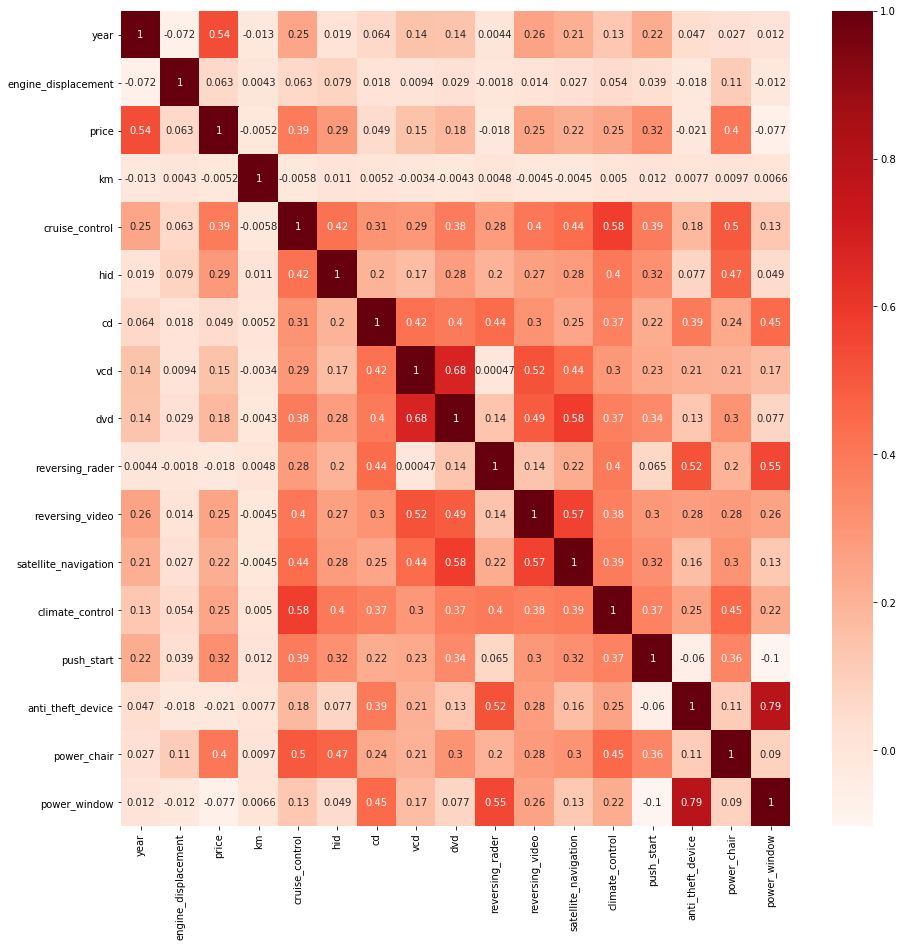

In [7]:
#Using Pearson Correlation
plt.figure(figsize=(15,15))
cor = used.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.Reds)
plt.show()

In [8]:
#Correlation with output variable
cor_target = abs(cor["price"])
#Selecting highly correlated features
relevant_features = cor_target[cor_target>0.35]
relevant_features

year              0.535858
price             1.000000
cruise_control    0.392337
power_chair       0.404331
Name: price, dtype: float64

In [9]:
# 做出新表格，欄位只選重要變數
a = used["brand"]
b = used["model"]
c = used["year"]
d = used["cruise_control"]
e = used["power_chair"]
f = used["city"]
g = used["price"]
used_analyze = pd.concat([a,b,c,d,e,f,g],axis=1,join='inner')
used_analyze

,brand,model,year,cruise_control,power_chair,city,price
0,FORD,KUGA,2018,1,1,台中市,84.0
1,BENZ,A180,2015,0,1,高雄市,102.8
2,BMW,220D,2015,1,1,桃園市,105.0
3,BMW,520.0,2011,0,1,台中市,92.0
4,BENZ,C300,2008,1,1,台南市,59.9
5,BENZ,GLC300,2016,0,0,桃園市,189.0
6,BENZ,SLK280,2008,1,1,台中市,66.8
7,BENZ,B180,2015,0,0,台中市,89.8
8,BENZ,ML350,2005,0,1,台中市,39.9
9,BMW,750.0,2009,1,1,高雄市,88.8


In [10]:
# brand、model、city 欄位做 One Hot Encoding
df = pd.get_dummies(used_analyze['brand'])
used_analyze_ohe = pd.concat([used_analyze, df],axis=1,join='inner')
df = pd.get_dummies(used_analyze['model'])
used_analyze_ohe = pd.concat([used_analyze_ohe, df],axis=1,join='inner')
df = pd.get_dummies(used_analyze['city'])
used_analyze_ohe = pd.concat([used_analyze_ohe, df],axis=1,join='inner')

used_analyze_ohe

,brand,model,year,cruise_control,power_chair,city,price,ABARTH,AUDI,BENTLEY,...,彰化縣,新北市,新竹市,新竹縣,桃園市,臺北市,花蓮縣,苗栗縣,雲林縣,高雄市
0,FORD,KUGA,2018,1,1,台中市,84.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,BENZ,A180,2015,0,1,高雄市,102.8,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,BMW,220D,2015,1,1,桃園市,105.0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
3,BMW,520.0,2011,0,1,台中市,92.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,BENZ,C300,2008,1,1,台南市,59.9,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,BENZ,GLC300,2016,0,0,桃園市,189.0,0,0,0,...,0,0,0,0,1,0,0,0,0,0
6,BENZ,SLK280,2008,1,1,台中市,66.8,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,BENZ,B180,2015,0,0,台中市,89.8,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,BENZ,ML350,2005,0,1,台中市,39.9,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,BMW,750.0,2009,1,1,高雄市,88.8,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [11]:
# 刪除 brand、model、city 欄位
import os
# used3 = used2.drop("cars_id", axis=1)
used_analyze_ohe = used_analyze_ohe.drop("brand", axis=1)
used_analyze_ohe = used_analyze_ohe.drop("model", axis=1)
used_analyze_ohe = used_analyze_ohe.drop("city", axis=1)

used_analyze_ohe

,year,cruise_control,power_chair,price,ABARTH,AUDI,BENTLEY,BENZ,BMW,CADILLAC,...,彰化縣,新北市,新竹市,新竹縣,桃園市,臺北市,花蓮縣,苗栗縣,雲林縣,高雄市
0,2018,1,1,84.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2015,0,1,102.8,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
2,2015,1,1,105.0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0
3,2011,0,1,92.0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,2008,1,1,59.9,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
5,2016,0,0,189.0,0,0,0,1,0,0,...,0,0,0,0,1,0,0,0,0,0
6,2008,1,1,66.8,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
7,2015,0,0,89.8,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
8,2005,0,1,39.9,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,2009,1,1,88.8,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1


In [12]:
# 區分自變數與應變數
x = used_analyze_ohe.drop("price", axis=1)
y = used_analyze_ohe['price']

In [13]:
# 切分出考試和考古題
from sklearn.model_selection import train_test_split
# 90%題目, 10%題目, 90%答案, 10%答案
x_train, x_test, y_train, y_test = train_test_split(x, 
                                                    y, 
                                                    test_size=0.1)

In [14]:
# 建立及驗證模型 (for迴圈)
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score
import numpy as np
import math
r2_score_list = []
for i in range(1,151):
    for j in range(1,6):
        reg = DecisionTreeRegressor(max_depth=i)
        # 訓練(fit)模型
        reg.fit(x_train, y_train)
        r2_score_list.append(r2_score(y_test, reg.predict(x_test)))

        
# r2_score_list = list(r2_score_list)    
print('max_depth:', math.floor((r2_score_list.index(max(r2_score_list))+5)/5))
print('R2 Score:', max(r2_score_list))
print(r2_score_list)

max_depth: 49
R2 Score: 0.9074995240340886
[0.25030500158112623, 0.25030500158112523, 0.2503050015811332, 0.25030500158112945, 0.2503050015811248, 0.49373642095679593, 0.49373642095679626, 0.4937364209567938, 0.49373642095679604, 0.4937364209567974, 0.6185243263168012, 0.6185243263168011, 0.618524326316801, 0.6185243263168008, 0.6185243263168001, 0.7072558921647848, 0.7072558921647849, 0.7072558921647849, 0.7072558921647848, 0.707255892164785, 0.744138548683696, 0.7441385486836961, 0.7441385486836962, 0.7441385486836961, 0.744138548683696, 0.7719769762988719, 0.771976976298872, 0.7719769762988719, 0.771976976298872, 0.7719769762988717, 0.7951729766409305, 0.7950883389973126, 0.7951729766409305, 0.7950883389973127, 0.7951729766409306, 0.8053731955747243, 0.8054578332183422, 0.8055657586390113, 0.8053731955747243, 0.8055657586390113, 0.8144145991462965, 0.8144429238019252, 0.8139499134639866, 0.8145465850935572, 0.814218634046338, 0.8191997644300121, 0.8190781801881932, 0.819289098906024

In [15]:
from sklearn.tree import export_graphviz
import graphviz
g = export_graphviz(reg, 
                    feature_names=x.columns, 
                    filled=True)
graphviz.Source(g)

In [ ]:
# 關閉連線
conn.close()

In [ ]:
# 存出成 csv 檔 (此處存成 excel 可讀的 ANSI 檔)
# used3.to_csv("D:\\used3_1233.csv", encoding="ANSI")